In [1]:
using Pkg

In [2]:
ENV["PYTHON"] = "/home/tung/anaconda3/envs/celldancer/bin/python3"

"/home/tung/anaconda3/envs/celldancer/bin/python3"

In [3]:
Pkg.build("PyCall")

    Building Conda ─→ `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/b19db3927f0db4151cb86d073689f2428e524576/build.log`
    Building PyCall → `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/9816a3826b0ebf49ab4926e2b18842ad8b5c8f04/build.log`


In [4]:
using JuloVelo
using Plots

In [5]:
adata = read_adata("data/JuloVelo_pre.h5ad")

AnnData object 18213 ✕ 2000

In [6]:
adata.uns["iroot"] = 2

2

In [7]:
normalize(adata)

AnnData object 18213 ✕ 2000

In [8]:
filter_and_gene_kinetics_predetermination(adata)

[ Info: 1172 genes are filtered due to low correlation between norm_u and norm_s
[ Info: See adata.var[!, "bad_correlation_genes"] for details
[ Info: 53 genes are filtered due to bad kinetics
[ Info: See adata.var[!, "bad_kinetics_genes"] for details
[ Info: 775 genes are used to infer velocity
[ Info: See adata.var[!, "train_genes"] for details


AnnData object 18213 ✕ 2000

In [9]:
reshape_data(adata)

[ Info: Data is reshaped to (2, 18213, 775)


AnnData object 18213 ✕ 2000

In [10]:
Kinetics = build_velocity_model(adata)

[ Info: Successfully initialize velocity model


Chain(
  SpatialDense(2 => 100, depth = 775, leakyrelu),  # 232_500 parameters
  SpatialDense(100 => 100, depth = 775, leakyrelu),  # 7_827_500 parameters
  SpatialDense(100 => 3, depth = 775, σ),  # 234_825 parameters
)                   # Total: 6 arrays, 8_294_825 parameters, 31.643 MiB.

In [11]:
density_sampling(adata)

[ Info: Sample 2400 cells


AnnData object 18213 ✕ 2000

In [12]:
train(adata, Kinetics)

[ Info: Training on gpu
[ Info: Training with Adam Optimizer
[ Info: TensorBoard logging at "/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/dentategyrus_lamanno/saves/"
[ Info: Start training


Epoch: 0  Train: (cos_loss = 53027.016f0, penalty = 2822.1973f0, AvgMeanCos = 0.9715f0)
Epoch: 1  Train: (cos_loss = 52281.375f0, penalty = 2821.9912f0, AvgMeanCos = 0.9719f0)
Epoch: 2  Train: (cos_loss = 51613.152f0, penalty = 2821.784f0, AvgMeanCos = 0.9723f0)
Epoch: 3  Train: (cos_loss = 51008.887f0, penalty = 2821.5747f0, AvgMeanCos = 0.9726f0)
Epoch: 4  Train: (cos_loss = 50451.125f0, penalty = 2821.3645f0, AvgMeanCos = 0.9729f0)
Epoch: 5  Train: (cos_loss = 49931.516f0, penalty = 2821.153f0, AvgMeanCos = 0.9732f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 6  Train: (cos_loss = 49432.96f0, penalty = 2820.9426f0, AvgMeanCos = 0.9734f0)
Epoch: 7  Train: (cos_loss = 48940.68f0, penalty = 2820.7314f0, AvgMeanCos = 0.9737f0)
Epoch: 8  Train: (cos_loss = 48443.54f0, penalty = 2820.5193f0, AvgMeanCos = 0.974f0)
Epoch: 9  Train: (cos_loss = 47952.96f0, penalty = 2820.3066f0, AvgMeanCos = 0.9742f0)
Epoch: 10  Train: (cos_loss = 47474.727f0, penalty = 2820.0928f0, AvgMeanCos = 0.9745f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 11  Train: (cos_loss = 47016.277f0, penalty = 2819.8782f0, AvgMeanCos = 0.9747f0)
Epoch: 12  Train: (cos_loss = 46577.305f0, penalty = 2819.663f0, AvgMeanCos = 0.975f0)
Epoch: 13  Train: (cos_loss = 46160.656f0, penalty = 2819.447f0, AvgMeanCos = 0.9752f0)
Epoch: 14  Train: (cos_loss = 45770.027f0, penalty = 2819.2297f0, AvgMeanCos = 0.9754f0)
Epoch: 15  Train: (cos_loss = 45404.86f0, penalty = 2819.011f0, AvgMeanCos = 0.9756f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 16  Train: (cos_loss = 45057.566f0, penalty = 2818.791f0, AvgMeanCos = 0.9758f0)
Epoch: 17  Train: (cos_loss = 44727.98f0, penalty = 2818.5706f0, AvgMeanCos = 0.976f0)
Epoch: 18  Train: (cos_loss = 44418.883f0, penalty = 2818.3489f0, AvgMeanCos = 0.9761f0)
Epoch: 19  Train: (cos_loss = 44129.28f0, penalty = 2818.1265f0, AvgMeanCos = 0.9763f0)
Epoch: 20  Train: (cos_loss = 43858.785f0, penalty = 2817.9036f0, AvgMeanCos = 0.9764f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 21  Train: (cos_loss = 43605.844f0, penalty = 2817.6794f0, AvgMeanCos = 0.9766f0)
Epoch: 22  Train: (cos_loss = 43369.492f0, penalty = 2817.4546f0, AvgMeanCos = 0.9767f0)
Epoch: 23  Train: (cos_loss = 43147.156f0, penalty = 2817.2292f0, AvgMeanCos = 0.9768f0)
Epoch: 24  Train: (cos_loss = 42939.402f0, penalty = 2817.0024f0, AvgMeanCos = 0.9769f0)
Epoch: 25  Train: (cos_loss = 42743.74f0, penalty = 2816.775f0, AvgMeanCos = 0.977f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 26  Train: (cos_loss = 42563.523f0, penalty = 2816.5466f0, AvgMeanCos = 0.9771f0)
Epoch: 27  Train: (cos_loss = 42394.375f0, penalty = 2816.3176f0, AvgMeanCos = 0.9772f0)
Epoch: 28  Train: (cos_loss = 42231.38f0, penalty = 2816.0872f0, AvgMeanCos = 0.9773f0)
Epoch: 29  Train: (cos_loss = 42077.05f0, penalty = 2815.8562f0, AvgMeanCos = 0.9774f0)
Epoch: 30  Train: (cos_loss = 41932.53f0, penalty = 2815.6238f0, AvgMeanCos = 0.9775f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 31  Train: (cos_loss = 41792.33f0, penalty = 2815.3909f0, AvgMeanCos = 0.9775f0)
Epoch: 32  Train: (cos_loss = 41659.645f0, penalty = 2815.157f0, AvgMeanCos = 0.9776f0)
Epoch: 33  Train: (cos_loss = 41532.55f0, penalty = 2814.9229f0, AvgMeanCos = 0.9777f0)
Epoch: 34  Train: (cos_loss = 41410.203f0, penalty = 2814.6877f0, AvgMeanCos = 0.9777f0)
Epoch: 35  Train: (cos_loss = 41295.996f0, penalty = 2814.4531f0, AvgMeanCos = 0.9778f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 36  Train: (cos_loss = 41188.934f0, penalty = 2814.2178f0, AvgMeanCos = 0.9779f0)
Epoch: 37  Train: (cos_loss = 41086.27f0, penalty = 2813.982f0, AvgMeanCos = 0.9779f0)
Epoch: 38  Train: (cos_loss = 40987.71f0, penalty = 2813.745f0, AvgMeanCos = 0.978f0)
Epoch: 39  Train: (cos_loss = 40893.25f0, penalty = 2813.5076f0, AvgMeanCos = 0.978f0)
Epoch: 40  Train: (cos_loss = 40802.992f0, penalty = 2813.2698f0, AvgMeanCos = 0.9781f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 41  Train: (cos_loss = 40715.14f0, penalty = 2813.0315f0, AvgMeanCos = 0.9781f0)
Epoch: 42  Train: (cos_loss = 40632.312f0, penalty = 2812.7932f0, AvgMeanCos = 0.9782f0)
Epoch: 43  Train: (cos_loss = 40553.055f0, penalty = 2812.5537f0, AvgMeanCos = 0.9782f0)
Epoch: 44  Train: (cos_loss = 40471.496f0, penalty = 2812.3142f0, AvgMeanCos = 0.9782f0)
Epoch: 45  Train: (cos_loss = 40394.62f0, penalty = 2812.0745f0, AvgMeanCos = 0.9783f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 46  Train: (cos_loss = 40316.54f0, penalty = 2811.8342f0, AvgMeanCos = 0.9783f0)
Epoch: 47  Train: (cos_loss = 40242.445f0, penalty = 2811.5942f0, AvgMeanCos = 0.9784f0)
Epoch: 48  Train: (cos_loss = 40171.79f0, penalty = 2811.353f0, AvgMeanCos = 0.9784f0)
Epoch: 49  Train: (cos_loss = 40103.027f0, penalty = 2811.1123f0, AvgMeanCos = 0.9784f0)
Epoch: 50  Train: (cos_loss = 40037.992f0, penalty = 2810.8713f0, AvgMeanCos = 0.9785f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 51  Train: (cos_loss = 39973.574f0, penalty = 2810.6294f0, AvgMeanCos = 0.9785f0)
Epoch: 52  Train: (cos_loss = 39910.656f0, penalty = 2810.3877f0, AvgMeanCos = 0.9785f0)
Epoch: 53  Train: (cos_loss = 39846.477f0, penalty = 2810.1462f0, AvgMeanCos = 0.9786f0)
Epoch: 54  Train: (cos_loss = 39786.84f0, penalty = 2809.904f0, AvgMeanCos = 0.9786f0)
Epoch: 55  Train: (cos_loss = 39727.438f0, penalty = 2809.6616f0, AvgMeanCos = 0.9786f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 56  Train: (cos_loss = 39672.605f0, penalty = 2809.4192f0, AvgMeanCos = 0.9787f0)
Epoch: 57  Train: (cos_loss = 39616.89f0, penalty = 2809.1763f0, AvgMeanCos = 0.9787f0)
Epoch: 58  Train: (cos_loss = 39563.727f0, penalty = 2808.9338f0, AvgMeanCos = 0.9787f0)
Epoch: 59  Train: (cos_loss = 39513.227f0, penalty = 2808.6904f0, AvgMeanCos = 0.9788f0)
Epoch: 60  Train: (cos_loss = 39462.36f0, penalty = 2808.4465f0, AvgMeanCos = 0.9788f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 61  Train: (cos_loss = 39411.61f0, penalty = 2808.203f0, AvgMeanCos = 0.9788f0)
Epoch: 62  Train: (cos_loss = 39361.113f0, penalty = 2807.9587f0, AvgMeanCos = 0.9788f0)
Epoch: 63  Train: (cos_loss = 39313.875f0, penalty = 2807.7144f0, AvgMeanCos = 0.9789f0)
Epoch: 64  Train: (cos_loss = 39266.035f0, penalty = 2807.4702f0, AvgMeanCos = 0.9789f0)
Epoch: 65  Train: (cos_loss = 39220.906f0, penalty = 2807.2256f0, AvgMeanCos = 0.9789f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 66  Train: (cos_loss = 39177.805f0, penalty = 2806.9807f0, AvgMeanCos = 0.9789f0)
Epoch: 67  Train: (cos_loss = 39135.414f0, penalty = 2806.735f0, AvgMeanCos = 0.979f0)
Epoch: 68  Train: (cos_loss = 39094.055f0, penalty = 2806.4897f0, AvgMeanCos = 0.979f0)
Epoch: 69  Train: (cos_loss = 39051.816f0, penalty = 2806.2441f0, AvgMeanCos = 0.979f0)
Epoch: 70  Train: (cos_loss = 39011.816f0, penalty = 2805.998f0, AvgMeanCos = 0.979f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 71  Train: (cos_loss = 38973.055f0, penalty = 2805.7524f0, AvgMeanCos = 0.979f0)
Epoch: 72  Train: (cos_loss = 38936.16f0, penalty = 2805.5066f0, AvgMeanCos = 0.9791f0)
Epoch: 73  Train: (cos_loss = 38898.348f0, penalty = 2805.2603f0, AvgMeanCos = 0.9791f0)
Epoch: 74  Train: (cos_loss = 38860.402f0, penalty = 2805.0142f0, AvgMeanCos = 0.9791f0)
Epoch: 75  Train: (cos_loss = 38822.46f0, penalty = 2804.767f0, AvgMeanCos = 0.9791f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 76  Train: (cos_loss = 38787.656f0, penalty = 2804.52f0, AvgMeanCos = 0.9791f0)
Epoch: 77  Train: (cos_loss = 38754.387f0, penalty = 2804.273f0, AvgMeanCos = 0.9792f0)
Epoch: 78  Train: (cos_loss = 38721.918f0, penalty = 2804.0254f0, AvgMeanCos = 0.9792f0)
Epoch: 79  Train: (cos_loss = 38689.03f0, penalty = 2803.7778f0, AvgMeanCos = 0.9792f0)
Epoch: 80  Train: (cos_loss = 38655.58f0, penalty = 2803.5303f0, AvgMeanCos = 0.9792f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 81  Train: (cos_loss = 38623.434f0, penalty = 2803.2827f0, AvgMeanCos = 0.9792f0)
Epoch: 82  Train: (cos_loss = 38592.28f0, penalty = 2803.0347f0, AvgMeanCos = 0.9793f0)
Epoch: 83  Train: (cos_loss = 38561.11f0, penalty = 2802.787f0, AvgMeanCos = 0.9793f0)
Epoch: 84  Train: (cos_loss = 38530.32f0, penalty = 2802.539f0, AvgMeanCos = 0.9793f0)
Epoch: 85  Train: (cos_loss = 38500.645f0, penalty = 2802.2908f0, AvgMeanCos = 0.9793f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 86  Train: (cos_loss = 38472.453f0, penalty = 2802.0427f0, AvgMeanCos = 0.9793f0)
Epoch: 87  Train: (cos_loss = 38443.523f0, penalty = 2801.7944f0, AvgMeanCos = 0.9793f0)
Epoch: 88  Train: (cos_loss = 38413.258f0, penalty = 2801.5461f0, AvgMeanCos = 0.9793f0)
Epoch: 89  Train: (cos_loss = 38383.93f0, penalty = 2801.298f0, AvgMeanCos = 0.9794f0)
Epoch: 90  Train: (cos_loss = 38355.38f0, penalty = 2801.0493f0, AvgMeanCos = 0.9794f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 91  Train: (cos_loss = 38326.688f0, penalty = 2800.8005f0, AvgMeanCos = 0.9794f0)
Epoch: 92  Train: (cos_loss = 38295.95f0, penalty = 2800.5522f0, AvgMeanCos = 0.9794f0)
Epoch: 93  Train: (cos_loss = 38266.984f0, penalty = 2800.3027f0, AvgMeanCos = 0.9794f0)
Epoch: 94  Train: (cos_loss = 38239.32f0, penalty = 2800.0537f0, AvgMeanCos = 0.9794f0)
Epoch: 95  Train: (cos_loss = 38210.848f0, penalty = 2799.8044f0, AvgMeanCos = 0.9795f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 96  Train: (cos_loss = 38183.074f0, penalty = 2799.5552f0, AvgMeanCos = 0.9795f0)
Epoch: 97  Train: (cos_loss = 38156.023f0, penalty = 2799.3052f0, AvgMeanCos = 0.9795f0)
Epoch: 98  Train: (cos_loss = 38129.79f0, penalty = 2799.056f0, AvgMeanCos = 0.9795f0)
Epoch: 99  Train: (cos_loss = 38103.832f0, penalty = 2798.806f0, AvgMeanCos = 0.9795f0)
Epoch: 100  Train: (cos_loss = 38079.973f0, penalty = 2798.5562f0, AvgMeanCos = 0.9795f0)


[ Info: Model is saved in saves/Kinetics.bson


Chain(
  SpatialDense(2 => 100, depth = 775, leakyrelu),  # 232_500 parameters
  SpatialDense(100 => 100, depth = 775, leakyrelu),  # 7_827_500 parameters
  SpatialDense(100 => 3, depth = 775, σ),  # 234_825 parameters
)                   # Total: 6 arrays, 8_294_825 parameters, 31.643 MiB.

In [13]:
velocity_estimation(adata, Kinetics);

[ Info: Velocity saved in adata.uns["velocity"]
[ Info: kinetics saved in adata.uns["kinetics"]


In [14]:
compute_cell_velocity(adata; basis = "tsne", pipeline_type = "cellDancer");

In [15]:
estimate_pseudotime(adata, 3, n_repeat = 5; basis = "tsne");

[ Info: Start estimate pseudotime, it may take a long time.
Generating Trajectories: 100%|██████████| 9865/9865 [00:00<00:00, 30150.05it/s]


Pseudo random number generator seeds are set to:  [0, 1, 2, 3, 4]
There are 3 clusters.
[0 1 2]
--- 15.640187740325928 seconds ---


In [16]:
write_adata(adata, filename = "data/JuloVelo", basis = "tsne")

# Plot figure

## Gene kinetics

In [17]:
palattes = Dict("CA"=> "#023fa5",
 "CA1-Sub"=> "#7d87b9",
 "CA2-3-4"=> "#bec1d4",
 "GlialProg"=> "#d6bcc0",
 "Granule"=> "#bb7784",
 "ImmAstro"=> "#8e063b",
 "ImmGranule1"=> "#4a6fe3",
 "ImmGranule2"=> "#8595e1",
 "Nbl1"=> "#b5bbe3",
 "Nbl2"=> "#e6afb9",
 "OPC"=> "#e07b91",
 "RadialGlia"=> "#d33f6a",
 "RadialGlia2"=> "#11c638",
 "nIPC"=> "#8dd593")

Dict{String, String} with 14 entries:
  "CA2-3-4"     => "#bec1d4"
  "CA"          => "#023fa5"
  "Nbl1"        => "#b5bbe3"
  "Nbl2"        => "#e6afb9"
  "CA1-Sub"     => "#7d87b9"
  "ImmGranule1" => "#4a6fe3"
  "RadialGlia2" => "#11c638"
  "GlialProg"   => "#d6bcc0"
  "Granule"     => "#bb7784"
  "nIPC"        => "#8dd593"
  "ImmAstro"    => "#8e063b"
  "ImmGranule2" => "#8595e1"
  "RadialGlia"  => "#d33f6a"
  "OPC"         => "#e07b91"

In [18]:
function gene_plot(x, x̂; part = 20)
    x_range = Array(range(0, 1, part))
    y_range = Array(range(0, 1, part))
    
    arrow_vector = Array{Float32}(undef, 0, 2)
    point_vector = Array{Float32}(undef, 0, 2)
    
    for i in 1:part - 1
        for j in 1:part - 1
            index = intersect(findall(k -> (k .>= x_range[i]) & (k .<= x_range[i + 1]), x[2, :]), 
            findall(k -> (k .>= y_range[j]) & (k .<= y_range[j + 1]), x[1, :]))
            
            if length(index) > 0
                selected = x̂[:, index]
            else
                continue
            end
            
            selected_vector = sum(selected, dims = 2) ./ size(selected, 2)
            scale = maximum(abs, selected_vector) / (x_range[i + 1] - x_range[i])
            selected_vector = selected_vector ./ scale
            #println(selected_vector)
            xcenter = (x_range[i + 1] + x_range[i]) / 2
            ycenter = (y_range[j + 1] + y_range[j]) / 2
            xarrow = selected_vector[2]
            yarrow = selected_vector[1]
            
            arrow_vector = vcat(arrow_vector, vec([xarrow, yarrow])')
            point_vector = vcat(point_vector, vec([xcenter, ycenter])')
        end
    end
    
    return arrow_vector, point_vector
end

gene_plot (generic function with 1 method)

In [19]:
theme(:vibrant, framestyle = :zerolines, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

In [20]:
GR.setarrowsize(0.5)

In [21]:
X = adata.uns["X"];
velocity = adata.uns["velocity"]
genes = adata.var_names[adata.var[!, "train_genes"]]
celltype = adata.obs[!, "clusters"]
labels = sort(unique(celltype));

In [22]:
idx = findfirst(x -> x == "Dcx", genes)

765

In [23]:
arrow_vector, point_vector = gene_plot(X[:, :, idx], velocity[:, :, idx])

([-0.02510890795976465 0.05263157894736842; 0.021043449332822314 0.05263157894736842; … ; -0.04174478611269807 -0.05263157894736836; -0.05263157894736848 -0.03286739563608042], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9210526315789473 0.5; 0.9736842105263157 0.39473684210526316])

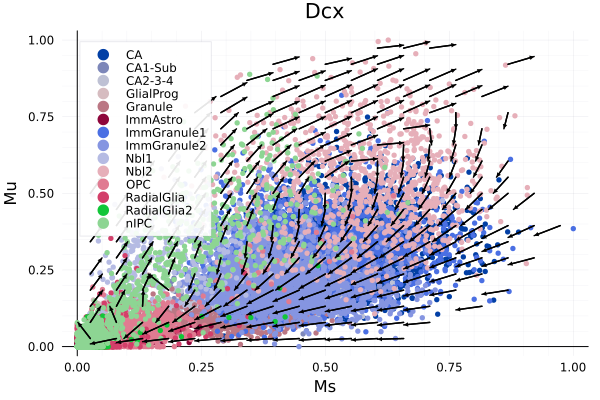

In [24]:
p1 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx], X[1, celltype .== label, idx], label = label, xlabel = "Ms", ylabel = "Mu", title = "Dcx", color = palattes[label])
end
quiver!(point_vector[:, 1], point_vector[:, 2], quiver = (arrow_vector[:, 1], arrow_vector[:, 2]), arrow = arrow(:closed), color = "#000000")

In [25]:
idx2 = findfirst(x -> x == "Sphkap", genes)

12

In [26]:
arrow_vector1, point_vector1 = gene_plot(X[:, :, idx2], velocity[:, :, idx2])

([0.009265694136416897 0.05263157894736842; 0.026586938263941363 0.05263157894736842; … ; 0.052631578947368474 0.045363832429043474; 0.05263157894736847 0.04123747987616833], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9736842105263157 0.8157894736842105; 0.9736842105263157 0.868421052631579])

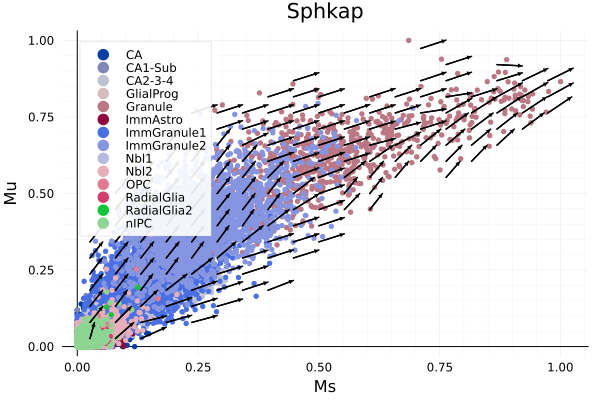

In [27]:
p2 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx2], X[1, celltype .== label, idx2], label = label, xlabel = "Ms", ylabel = "Mu", title = "Sphkap", color = palattes[label])
end
quiver!(point_vector1[:, 1], point_vector1[:, 2], quiver = (arrow_vector1[:, 1], arrow_vector1[:, 2]), arrow = arrow(:closed), color = "#000000")

In [28]:
idx3 = findfirst(x -> x == "Pid1", genes)

13

In [29]:
arrow_vector2, point_vector2 = gene_plot(X[:, :, idx3], velocity[:, :, idx3])

([0.005095122592711651 0.05263157894736842; 0.022989316299452407 0.05263157894736842; … ; -0.010322568825409772 -0.052631578947368474; -0.006158342010772484 -0.05263157894736847], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9736842105263157 0.8157894736842105; 0.9736842105263157 0.868421052631579])

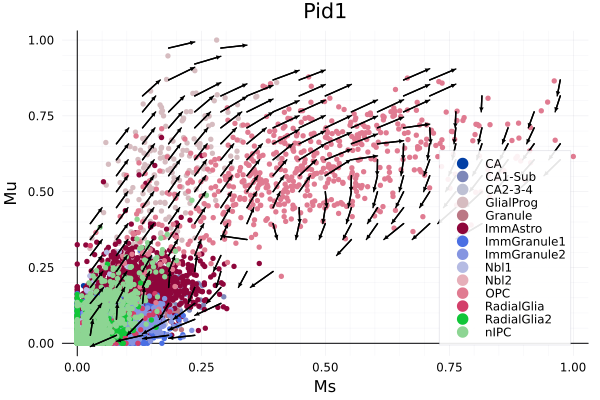

In [30]:
p3 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx3], X[1, celltype .== label, idx3], label = label, xlabel = "Ms", ylabel = "Mu", title = "Pid1", color = palattes[label])
end
quiver!(point_vector2[:, 1], point_vector2[:, 2], quiver = (arrow_vector2[:, 1], arrow_vector2[:, 2]), arrow = arrow(:closed), color = "#000000")

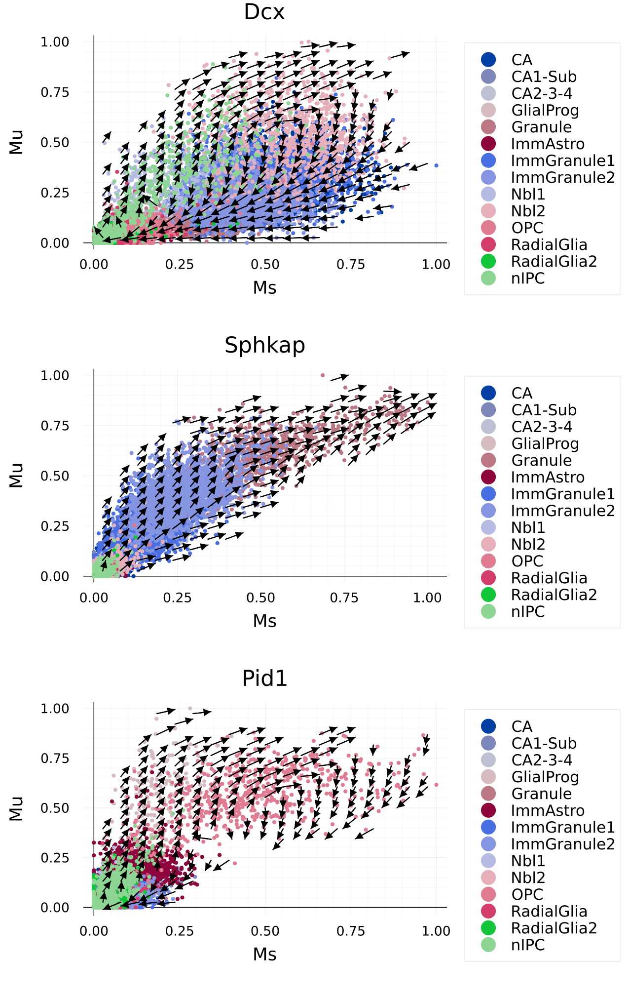

In [31]:
p = plot(p1, p2, p3, layout = (3, 1), size = (850, 1350), dpi = 150, left_margins = 1.0Plots.cm, bottom_margins = 1.0Plots.cm, legendfontsize = 14, legend = :outertopright
    , xtickfontsize = 12, ytickfontsize = 12, xguidefontsize = 16, yguidefontsize = 16, titlefontsize = 20)

In [32]:
savefig(p, "figure/JuloVelo_velocity_vector.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/dentategyrus_lamanno/figure/JuloVelo_velocity_vector.png"

## kinetics embedding

In [33]:
kinetics_embedding(adata; basis = "umap", min_dist = 0.3);

In [34]:
embedding = adata.obsm["kinetics_umap"];

In [35]:
celltype = adata.obs[!, "clusters"]
labels = sort(unique(celltype))

14-element Vector{String}:
 "CA"
 "CA1-Sub"
 "CA2-3-4"
 "GlialProg"
 "Granule"
 "ImmAstro"
 "ImmGranule1"
 "ImmGranule2"
 "Nbl1"
 "Nbl2"
 "OPC"
 "RadialGlia"
 "RadialGlia2"
 "nIPC"

In [36]:
theme(:vibrant, framestyle = :axes, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

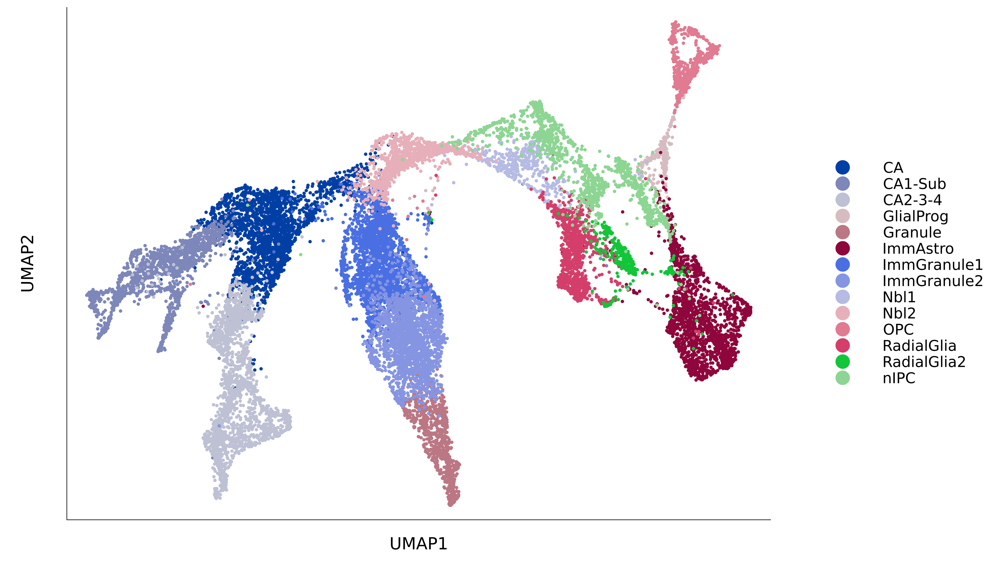

In [37]:
p = scatter(size = (1600, 900), fg_legend = :transparent, left_margins = 2.0Plots.cm, bottom_margins = 1.0Plots.cm, dpi = 300) #
for label in labels
    scatter!(embedding[celltype .== label, 1], embedding[celltype .== label, 2], label = label, legend=:outerright, legendfontsize = 16, color = palattes[label]
        , xlabel = "UMAP1", ylabel = "UMAP2", xtick = nothing, yticks = nothing, xguidefontsize = 18, yguidefontsize = 18)
end
p

In [38]:
savefig(p, "figure/hippocampus_kinetics_embedding.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/dentategyrus_lamanno/figure/hippocampus_kinetics_embedding.png"